<a href="https://colab.research.google.com/github/zfurman56/linear-representations/blob/main/linear_representations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

We want to investigate the hypothesis that features are represented linearly in deep neural networks. There certainly seems to be cases where this is true, but we want to investigate if this is a mostly universal phenomenon.

We'll train a three-hidden-layer network to approximate $f(x,y) = (x^3, -y^3)$. This function has two inputs and two outputs, but they're two independent functions glued together. It's entirely possible for this function to be approximated by two completely separate subnetworks.

If the linear representation hypothesis is true, we should expect the intermediate representations of the two independent functions to stay in separate linear subspaces of activation space, rather than mixing and unmixing nonlinearly in the middle of the network.

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import io
import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from scipy.ndimage import gaussian_filter
from sklearn.decomposition import PCA
from PIL import Image

torch.manual_seed(0)
np.random.seed(0)

In [16]:
# Define the target functions
def target_functions(x, y):
    return x**3, -y**3

# Generate training data
num_samples = 2000
inputs = torch.rand(num_samples, 2) * 4 - 2  # Random values in the range of [-2, 2]
x, y = inputs[:, 0], inputs[:, 1]
targets = torch.stack(target_functions(x, y), dim=1)

def train(model):
    # Set up the loss function and the optimizer
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Train the neural network
    num_epochs = 10000
    for epoch in range(num_epochs):
        # Forward pass
        predictions = model(inputs)
        loss = criterion(predictions, targets)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Print loss every 500 epochs
        if (epoch + 1) % 500 == 0:
            print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

    print("Training completed.")


In [17]:
model = nn.Sequential(
    nn.Linear(2, 40),
    nn.ReLU(),
    nn.Linear(40, 40),
    nn.ReLU(),
    nn.Linear(40, 40),
    nn.ReLU(),
    nn.Linear(40, 40),
    nn.ReLU(),
    nn.Linear(40, 2)
)

train(model)

Epoch [500/10000], Loss: 0.0087
Epoch [1000/10000], Loss: 0.0055
Epoch [1500/10000], Loss: 0.0031
Epoch [2000/10000], Loss: 0.0044
Epoch [2500/10000], Loss: 0.0025
Epoch [3000/10000], Loss: 0.0034
Epoch [3500/10000], Loss: 0.0021
Epoch [4000/10000], Loss: 0.0020
Epoch [4500/10000], Loss: 0.0021
Epoch [5000/10000], Loss: 0.0017
Epoch [5500/10000], Loss: 0.0016
Epoch [6000/10000], Loss: 0.0016
Epoch [6500/10000], Loss: 0.0015
Epoch [7000/10000], Loss: 0.0015
Epoch [7500/10000], Loss: 0.0014
Epoch [8000/10000], Loss: 0.0015
Epoch [8500/10000], Loss: 0.0013
Epoch [9000/10000], Loss: 0.0013
Epoch [9500/10000], Loss: 0.0013
Epoch [10000/10000], Loss: 0.0013
Training completed.


We verify that the function is correct (checking the first subfunction, $x^3$):

In [19]:
# Generate data for x in range [-2, 2], and y = 0
x_values = torch.linspace(-2, 2, 100).unsqueeze(1)
y_values = torch.zeros_like(x_values)
inputs = torch.cat((x_values, y_values), dim=1)

# Get the first output values
with torch.no_grad():
    output1_values = model(inputs)[:, 0].numpy()

# Create the plot using Plotly
fig = go.Figure()
fig.add_trace(go.Scatter(x=x_values.squeeze(), y=output1_values, mode='lines', name='Output 1'))
fig.update_layout(title="First Output vs x", xaxis_title="x", yaxis_title="Output 1")
fig.show()

We can confirm that using a single dense model here is not necessary for performance - removing connections such that each subfunction receives its own subnetwork achieves lower loss, in fact:

In [18]:
class ParallelMLPs(nn.Module):
    def __init__(self):
        super(ParallelMLPs, self).__init__()

        self.mlp1 = nn.Sequential(
            nn.Linear(1, 20),
            nn.ReLU(),
            nn.Linear(20, 20),
            nn.ReLU(),
            nn.Linear(20, 20),
            nn.ReLU(),
            nn.Linear(20, 20),
            nn.ReLU(),
            nn.Linear(20, 1)
        )

        self.mlp2 = nn.Sequential(
            nn.Linear(1, 20),
            nn.ReLU(),
            nn.Linear(20, 20),
            nn.ReLU(),
            nn.Linear(20, 20),
            nn.ReLU(),
            nn.Linear(20, 20),
            nn.ReLU(),
            nn.Linear(20, 1)
        )

    def forward(self, x):
        #print(x.size(), x[..., 0].unsqueeze(1).size())
        output1 = self.mlp1(x[..., 0].unsqueeze(-1))
        output2 = self.mlp2(x[..., 1].unsqueeze(-1))
        return torch.hstack((output1, output2))

parallel_model = ParallelMLPs()
train(parallel_model)


Epoch [500/10000], Loss: 0.0046
Epoch [1000/10000], Loss: 0.0007
Epoch [1500/10000], Loss: 0.0004
Epoch [2000/10000], Loss: 0.0003
Epoch [2500/10000], Loss: 0.0003
Epoch [3000/10000], Loss: 0.0003
Epoch [3500/10000], Loss: 0.0002
Epoch [4000/10000], Loss: 0.0002
Epoch [4500/10000], Loss: 0.0003
Epoch [5000/10000], Loss: 0.0002
Epoch [5500/10000], Loss: 0.0002
Epoch [6000/10000], Loss: 0.0002
Epoch [6500/10000], Loss: 0.0001
Epoch [7000/10000], Loss: 0.0001
Epoch [7500/10000], Loss: 0.0001
Epoch [8000/10000], Loss: 0.0001
Epoch [8500/10000], Loss: 0.0001
Epoch [9000/10000], Loss: 0.0001
Epoch [9500/10000], Loss: 0.0001
Epoch [10000/10000], Loss: 0.0001
Training completed.


Now let's examine the internals of the dense model. Let's apply a dimensionality reduction (PCA) to the activations of our model. If we expect to see features linearly represented in activation space, the principal directions should be roughly "indpendent" of each other.

In [5]:
# Sweep x and y from -2 to 2
num_points = 100
x_values = np.linspace(-2, 2, num_points)
y_values = np.linspace(-2, 2, num_points)
xx, yy = np.meshgrid(x_values, y_values)
input_grid = torch.tensor(np.column_stack((xx.flatten(), yy.flatten())), dtype=torch.float32)

# Measure the third-layer activations
with torch.no_grad():
    activations = model[:6](input_grid).detach().numpy()

## Reduce the activations to 3 dimensions using a random linear transformation
#random_transform = np.random.rand(20, 3)
#reduced_activations = activations @ random_transform

## Reduce the activations to 3 dimensions using PCA
pca = PCA(n_components=3)
reduced_activations = pca.fit_transform(activations)

# Create a 3D surface plot using Plotly
fig = px.scatter_3d(
    x=reduced_activations[:, 0],
    y=reduced_activations[:, 1],
    z=reduced_activations[:, 2],
    color=input_grid[:, 0],
    labels={'x': 'X', 'y': 'Y', 'z': 'Z', 'color': 'Input_x'},
    title="Dimensionally-Reduced Third-Layer Activations"
)
fig.show()

You can try other methods, but it seems like random linear projections, t-SNE, or UMAP all work worse.

We can also check the higher principle components, and see what magnitude they have. We should expect the first two to be large, and the rest near-zero:

In [5]:
U, S, V = np.linalg.svd(activations)

fig = px.scatter(S)
fig.show()

We can see that higher principle components do drop off in magnitude, but not the way we'd expect. Both "1 feature" and "3 features" seem like reasonable conclusions from the singular values, but neither would be right.

We can also examine this from the lens of polysemanticity and superposition. It's known that many neurons in real models don't cleanly respond to one concept or "feature" of the input, but seem to mix them together polysemantically. [Recent work](https://transformer-circuits.pub/2022/toy_model/index.html) hypothesized that features may still be directions in activation space, but they may not be in the neuron basis, and they may be overcomplete.

We plot the first layer weights and notice that most first layer neurons respond to both inputs:

In [42]:
fig = px.scatter(x=model[0].weight.detach()[:, 0], y=model[0].weight.detach()[:, 1], labels={'x':'Input 1 weight', 'y':'Input 2 weight'})
fig.show()

Beyond the  first layer, we can see more generally that most neurons activate with respect to both inputs:



In [ ]:
neuron_index = 30

surface = go.Surface(x=xx, y=yy, z=activations[:, neuron_index].reshape(100, 100))
data = [surface]

layout = go.Layout(
    title="Test Plot",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Interpolated Value",
    ),
)

fig = go.Figure(data=data, layout=layout)
fig.show()

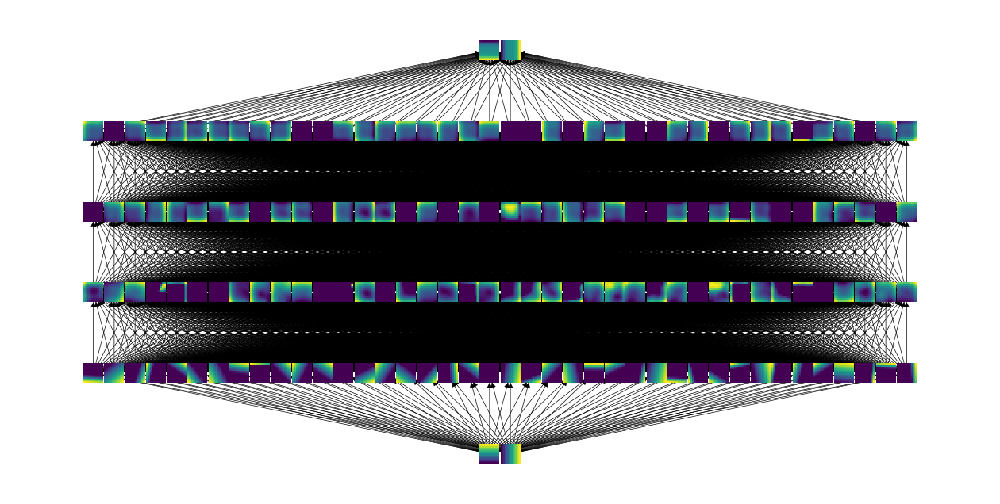

In [54]:
num_points_lr = 10
x_values_lr = np.linspace(-2, 2, num_points_lr)
y_values_lr = np.linspace(-2, 2, num_points_lr)
xx_lr, yy_lr = np.meshgrid(x_values_lr, y_values_lr)
input_grid_lr = torch.tensor(np.column_stack((xx_lr.flatten(), yy_lr.flatten())), dtype=torch.float32)

# Get activations of ReLU layers
responses = [input_grid_lr, input_grid_lr]
for layer in model:
    with torch.no_grad():
        responses[-1] = layer(responses[-1])
        if isinstance(layer, nn.ReLU):
            responses.append(responses[-1])

# Create a directed graph
G = nx.DiGraph()

# Create a mapping for nodes to image
node_to_img = {}

# Define a helper function for creating an image box
def get_image_box(image_np):
    image = Image.open(io.BytesIO(image_np))
    return OffsetImage(image, zoom=0.04)

# Add nodes to the graph and assign images to nodes
for i, response in enumerate(responses):
    response_grid = response.detach().numpy().reshape(len(x_values_lr), len(y_values_lr), -1)
    for j in range(response_grid.shape[-1]):
        fig, ax = plt.subplots()
        ax.imshow(response_grid[:, :, j], origin='lower', extent=(-2, 2, -2, 2))
        plt.axis('off')

        # Convert plot to PNG image
        buf = io.BytesIO()
        plt.tight_layout()
        plt.savefig(buf, bbox_inches='tight', pad_inches=0, format='png')
        buf.seek(0)
        plt.close(fig)

        node_id = f"{i + 1}_{j + 1}"
        G.add_node(node_id)
        node_to_img[node_id] = buf.getvalue()

# Connect edges
for i in range(1, len(responses)):
    for j in range(responses[i-1].shape[1]):
        for k in range(responses[i].shape[1]):
            G.add_edge(f"{i}_{j + 1}", f"{i + 1}_{k + 1}")

for layer, nodes in enumerate(nx.topological_generations(G)):
    # `multipartite_layout` expects the layer as a node attribute, so add the
    # numeric layer value as a node attribute
    for node in nodes:
        G.nodes[node]["layer"] = layer

# Draw the graph with images
fig, ax = plt.subplots(figsize=(16,8))

# Compute the multipartite_layout using the "layer" node attribute
pos = nx.multipartite_layout(G, subset_key="layer", align="horizontal")
nx.draw(G, pos, node_color='none', width=0.5, ax=ax)

# Add images to nodes
for node in G.nodes:
    imagebox = AnnotationBbox(get_image_box(node_to_img[node]), pos[node], frameon=False)
    ax.add_artist(imagebox)

plt.show()


Here we see polysemanticity as well, but it's unclear if the features are being linearly represented. It's possible that polysemanticity arises "by default" in deep models, simply because the model has no reason to align features with neurons/directions.

Perhaps we're just not looking the right basis? We can check this looking at the SVD of the weight matrices. This is also a perspective suggested by [recent work](https://www.lesswrong.com/posts/mkbGjzxD8d8XqKHzA/the-singular-value-decompositions-of-transformer-weight) which uses the SVD of weight matrices to interpret large language models.

In [ ]:
U, S, V = np.linalg.svd(model[2].weight.detach())

fig = px.scatter(S)
fig.show()

The good news is that there's definitely signal here - if you compare with a random matrix, the SVD won't look like this.

On the other hand, it's very hard to tell that there are two features from this plot. There's also a substantial proportion of non-zero singular vectors.

We can also try to recover linear features from activations by training a linear probe to reconstruct the input or output using the activations. This seems to work very well! Unfortunately this strategy also works with networks with completely random weights. This is a known phenomenon, but we can see it for ourselves:

In [ ]:
#rand_model = nn.Sequential(
#    nn.Linear(2, 40),
#    nn.ReLU(),
#    nn.Linear(40, 40),
#    nn.ReLU(),
#    nn.Linear(40, 40),
#    nn.ReLU(),
#    nn.Linear(40, 40),
#    nn.ReLU(),
#    nn.Linear(40, 2)
#)

inputs = (torch.rand(10000, 2) * 4) - 2
outputs = model(inputs).detach()

# Switch model to rand_model here to see performance when the inputs are coming
# from a random network with the same architecture
input_activations = model[:2](inputs).detach()

# Define the linear regression model
linear_model = nn.Linear(40, 2)

# Define the loss function and the optimizer
loss_fn = nn.MSELoss()
optimizer = optim.Adam(linear_model.parameters(), lr=0.01)

# Train the linear model
num_epochs = 10000
for epoch in range(num_epochs):
    optimizer.zero_grad()
    predictions = linear_model(input_activations)
    loss = loss_fn(predictions, outputs)
    loss.backward()
    optimizer.step()

    if (epoch+1) % 1000 == 0:
        print(f'Epoch: {epoch+1}, Loss: {loss.item()}')

# Evaluate the model's performance
linear_model.eval()
approximated_outputs = linear_model(input_activations).detach()

with torch.no_grad():
   loss = loss_fn(approximated_outputs, outputs).item()

print(f"\nFinal loss: {loss}")


Epoch: 1000, Loss: 0.08729024976491928
Epoch: 2000, Loss: 0.043284934014081955
Epoch: 3000, Loss: 0.03331727534532547
Epoch: 4000, Loss: 0.02797268144786358
Epoch: 5000, Loss: 0.02525089867413044
Epoch: 6000, Loss: 0.023818043991923332
Epoch: 7000, Loss: 0.022892581298947334
Epoch: 8000, Loss: 0.02234385907649994
Epoch: 9000, Loss: 0.022207094356417656
Epoch: 10000, Loss: 0.021930865943431854

Final loss: 0.021930789574980736


This suggests that the linear "features" learned by the probe are not in fact causal, as prior work has found in some cases. We can verify this by using the directions found by the probe to intervene.

In [ ]:
# Increase the y output by 0.1
desired_output_change = torch.tensor((0.0, 0.1))

# Random test input
test_input = (torch.rand(2) * 4) - 2
input_activations = model[:2](test_input)
unperturbed_output = model[2:](input_activations)
desired_output = unperturbed_output + desired_output_change
predicted_unperturbed_output = linear_model(input_activations)

# Find the intervention direction and modify the activations 
intervention = linear_model.weight.detach().T @ desired_output_change
intervened_activations = input_activations + intervention
intervened_output = model[2:](intervened_activations)

print(f"Unperturbed output: {unperturbed_output.detach()}")
print(f"Predicted unperturbed output: {predicted_unperturbed_output.detach()}\n")

print(f"Desired output: {desired_output.detach()}")
print(f"Intervened output: {intervened_output.detach()}")


Unperturbed output: tensor([-0.8860,  3.4227])
Predicted unperturbed output: tensor([-0.8767,  3.7527])

Desired output: tensor([-0.8860,  3.5227])
Intervened output: tensor([-0.4651, 20.6940])


##Extras

Animating how the dimensionality reduction changes as we interpolate between two random matrices:

In [ ]:
import plotly.graph_objs as go

# Generate two random linear transformation matrices
random_transform_1 = np.random.rand(40, 3)
random_transform_2 = np.random.rand(40, 3)

# Interpolate between the two transformation matrices
num_frames = 30
interpolated_transforms = [
    (1 - t) * random_transform_1 + t * random_transform_2
    for t in np.linspace(0, 1, num_frames)
]

# Reduce the activations using the interpolated transformation matrices
reduced_activations_list = [
    activations @ interpolated_transform
    for interpolated_transform in interpolated_transforms
]

# Create an animated 3D scatter plot using Plotly
frames = [
    go.Frame(
        data=go.Scatter3d(
            x=reduced_activations[:, 0],
            y=reduced_activations[:, 1],
            z=reduced_activations[:, 2],
            mode="markers",
            marker=dict(size=5, color=input_grid[:, 0], colorscale="Viridis"),
        ),
        name=str(i)
    )
    for i, reduced_activations in enumerate(reduced_activations_list)
]

layout = go.Layout(
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z",
    ),
    title="Animated Dimensionally-Reduced First-Layer Activations",
    sliders=[
        dict(
            steps=[
                dict(
                    method="animate",
                    args=[
                        [f.name],
                        dict(mode="immediate", frame=dict(duration=0, redraw=True)),
                    ],
                    label=f"{i}/{num_frames}",
                )
                for i, f in enumerate(frames)
            ],
            len=1,
            x=0,
            y=0,
            pad=dict(t=30),
            currentvalue=dict(visible=True, prefix="Frame: ", xanchor="center"),
        )
    ],
    updatemenus=[
        dict(
            type="buttons",
            showactive=False,
            buttons=[
                dict(
                    label="Play",
                    method="animate",
                    args=[
                        None,
                        dict(frame=dict(duration=100, redraw=True), fromcurrent=True),
                    ],
                )
            ],
            x=0,
            y=0,
            xanchor="left",
            yanchor="top",
            pad=dict(t=40, r=10),
        )
    ],
)

figure = go.Figure(data=frames[0]["data"], layout=layout, frames=frames)
figure.show()

Plotting the polytopes for the first output:

In [ ]:
# Create a high-resolution meshgrid for the input values
resolution = 200
x = np.linspace(-4, 4, resolution)
y = np.linspace(-4, 4, resolution)
x_grid, y_grid = np.meshgrid(x, y)

# Pass the input values through the network to get the output values
input_data = torch.tensor(np.array([x_grid.flatten(), y_grid.flatten()]).T, dtype=torch.float32)
input_data.requires_grad_(True)
output_data = model(input_data)[:, 1]
z_grid = output_data.detach().numpy().reshape(x_grid.shape)

# Calculate the gradients of the output with respect to the inputs
output_data.sum().backward()
grads = input_data.grad.detach().numpy()

# Find the unique gradient values and assign a color to each unique value
unique_grads, unique_indices = np.unique(grads, axis=0, return_inverse=True)
colors = np.array([np.random.permutation(len(unique_grads)),] * len(grads)).flatten()[unique_indices]
colors_grid = colors.reshape(x_grid.shape)

# Normalize the colors to [0, 1] range
normalized_colors = (colors_grid - colors_grid.min()) / (colors_grid.max() - colors_grid.min())

# Apply Gaussian blur to smooth the edges between regions
smooth_colors = gaussian_filter(normalized_colors, sigma=1)

# Create a surface plot with different colors for each piecewise-linear region
fig = go.Figure(go.Surface(x=x_grid, y=y_grid, z=z_grid, surfacecolor=normalized_colors, colorscale='plasma'))

fig.update_layout(scene=dict(
        xaxis_title='Input x',
        yaxis_title='Input y',
        zaxis_title='Output z'))

fig.show()